In [3]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import Ridge, Lasso, RidgeCV, LassoCV, ElasticNet, ElasticNetCV, LogisticRegression, LogisticRegressionCV
from sklearn.model_selection import train_test_split
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.metrics import accuracy_score, confusion_matrix, roc_curve, roc_auc_score
import matplotlib.pyplot as plt
from pandas_profiling import ProfileReport
import seaborn as sns
import pickle as p

C:\Users\Sumit\AppData\Local\Temp\ipykernel_3816\3047420018.py:9: DeprecationWarning: `import pandas_profiling` is going to be deprecated by April 1st. Please use `import ydata_profiling` instead.
  from pandas_profiling import ProfileReport


In [4]:
df = pd.read_csv('diabetes.csv')

In [5]:
df

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148,72,35,0,33.6,0.627,50,1
1,1,85,66,29,0,26.6,0.351,31,0
2,8,183,64,0,0,23.3,0.672,32,1
3,1,89,66,23,94,28.1,0.167,21,0
4,0,137,40,35,168,43.1,2.288,33,1
...,...,...,...,...,...,...,...,...,...
763,10,101,76,48,180,32.9,0.171,63,0
764,2,122,70,27,0,36.8,0.340,27,0
765,5,121,72,23,112,26.2,0.245,30,0
766,1,126,60,0,0,30.1,0.349,47,1


In [12]:
ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [10]:
df['BMI'] = df['BMI'].replace(0,df['BMI'].mean())

In [9]:
df.columns

Index(['Pregnancies', 'Glucose', 'BloodPressure', 'SkinThickness', 'Insulin',
       'BMI', 'DiabetesPedigreeFunction', 'Age', 'Outcome'],
      dtype='object')

In [16]:
df['BloodPressure'] = df['BloodPressure'].replace(0, df['BloodPressure'].mean())

In [11]:
df['Insulin'] = df['Insulin'].replace(0, df['Insulin'].mean())

In [12]:
df['Glucose'] = df['Glucose'].replace(0, df['Glucose'].mean())

In [13]:
df['SkinThickness'] = df['SkinThickness'].replace(0, df['SkinThickness'].mean())

In [20]:
ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [6]:
%matplotlib inline

<AxesSubplot: >

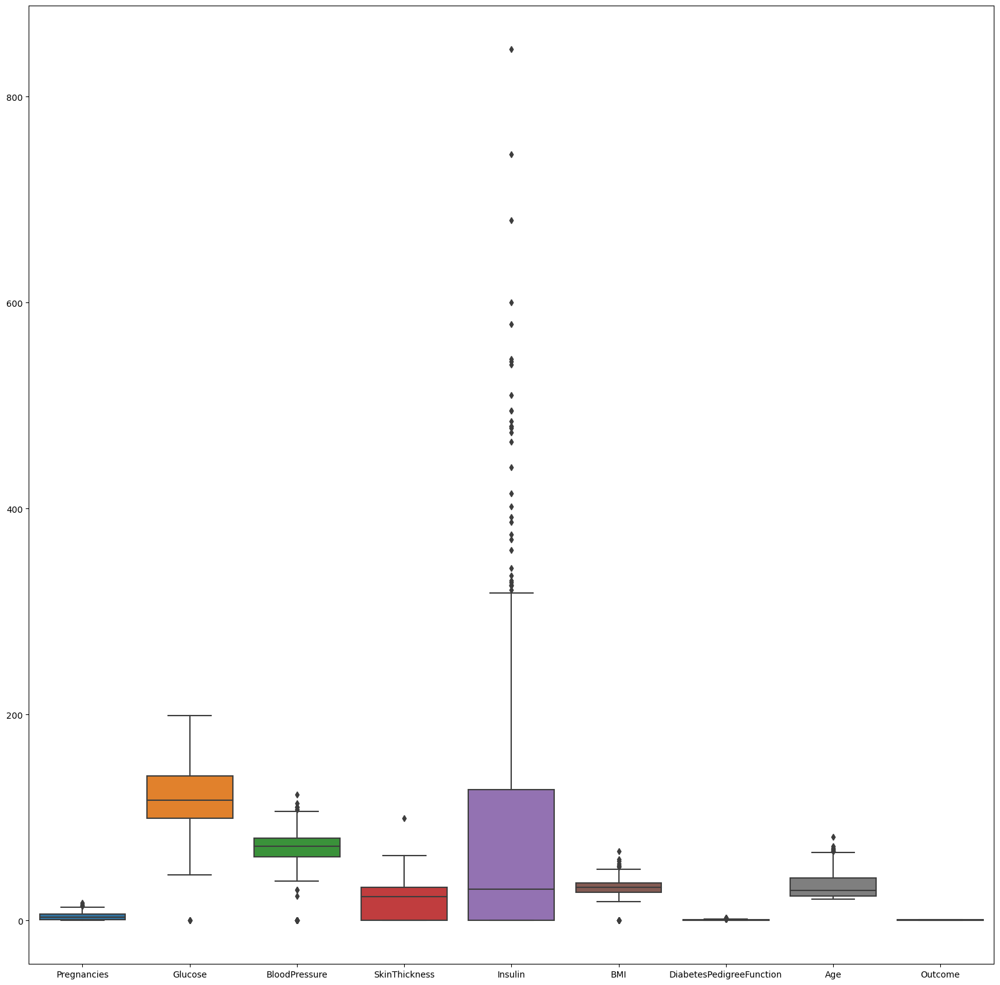

In [7]:
fig, ax = plt.subplots(figsize = (20,20))
sns.boxplot(data = df, ax = ax)

Outliers treatment

By Experimenting with quatrile ranges for different data sets


In [34]:
q = df['Insulin'].quantile(.90)
df_new = df[df['Insulin']<q]


q = df['Pregnancies'].quantile(.98)
df_new = df_new[df_new['Pregnancies']<q]


q = df['SkinThickness'].quantile(.99)
df_new = df_new[df_new['SkinThickness']<q]

q = df['BMI'].quantile(.99)
df_new = df_new[df_new['BMI']<q]

q = df['DiabetesPedigreeFunction'].quantile(.99)
df_new = df_new[df_new['DiabetesPedigreeFunction']<q]

q = df['Age'].quantile(.99)
df_new = df_new[df_new['Age']<q]



In [35]:
df_new

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148.0,72,35.000000,79.799479,33.6,0.627,50,1
1,1,85.0,66,29.000000,79.799479,26.6,0.351,31,0
2,8,183.0,64,20.536458,79.799479,23.3,0.672,32,1
3,1,89.0,66,23.000000,94.000000,28.1,0.167,21,0
5,5,116.0,74,20.536458,79.799479,25.6,0.201,30,0
...,...,...,...,...,...,...,...,...,...
763,10,101.0,76,48.000000,180.000000,32.9,0.171,63,0
764,2,122.0,70,27.000000,79.799479,36.8,0.340,27,0
765,5,121.0,72,23.000000,112.000000,26.2,0.245,30,0
766,1,126.0,60,20.536458,79.799479,30.1,0.349,47,1


<AxesSubplot: >

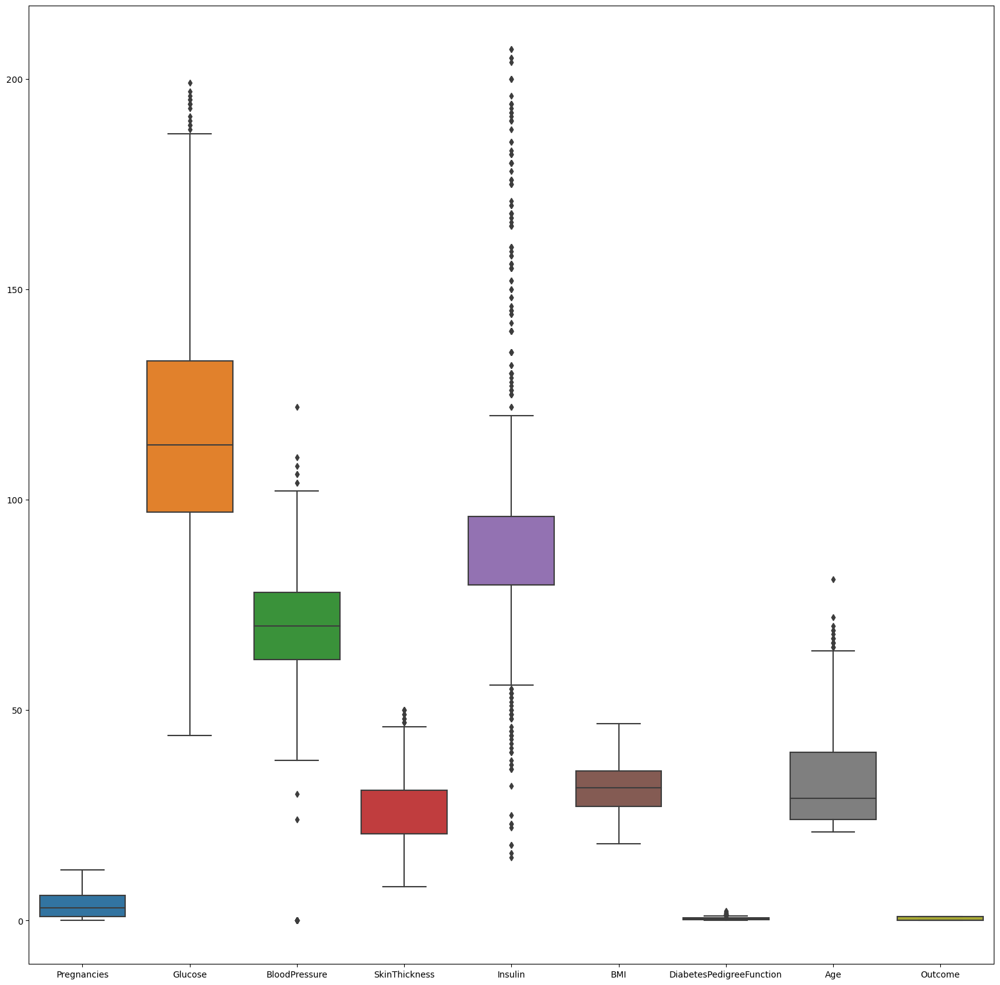

In [32]:
fig, ax = plt.subplots(figsize = (20,20))
sns.boxplot(data = df_new, ax = ax)

In [33]:
ProfileReport(df_new)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Separate the new data set into x and y groups

In [52]:
y = df_new['Outcome']
y

0      1
1      0
2      1
3      0
5      0
      ..
763    0
764    0
765    0
766    1
767    0
Name: Outcome, Length: 643, dtype: int64

In [51]:
X = df_new.drop(columns=['Outcome'])
X

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age
0,6,148.0,72,35.000000,79.799479,33.6,0.627,50
1,1,85.0,66,29.000000,79.799479,26.6,0.351,31
2,8,183.0,64,20.536458,79.799479,23.3,0.672,32
3,1,89.0,66,23.000000,94.000000,28.1,0.167,21
5,5,116.0,74,20.536458,79.799479,25.6,0.201,30
...,...,...,...,...,...,...,...,...
763,10,101.0,76,48.000000,180.000000,32.9,0.171,63
764,2,122.0,70,27.000000,79.799479,36.8,0.340,27
765,5,121.0,72,23.000000,112.000000,26.2,0.245,30
766,1,126.0,60,20.536458,79.799479,30.1,0.349,47


The Data columns in the data set are varying in different different scales and ranges.

The Data set is fluctuating a lot, so we have to do a standard scaling transformation.

The idea is to reduce the data fluctuations in the data set though standard scaling

In [44]:
scalar = StandardScaler()
scalar.fit_transform(df_new)

array([[ 0.80230673,  1.05580875,  0.18717194, ...,  0.62838416,
         1.61001692,  1.4669563 ],
       [-0.86938227, -1.1421868 , -0.11919604, ..., -0.3252998 ,
        -0.12619781, -0.68168357],
       [ 1.47098233,  2.27691738, -0.2213187 , ...,  0.78387611,
        -0.03481809,  1.4669563 ],
       ...,
       [ 0.46796893,  0.11381065,  0.18717194, ..., -0.69156972,
        -0.21757754, -0.68168357],
       [-0.86938227,  0.28825474, -0.42556402, ..., -0.33221055,
         1.33587775,  1.4669563 ],
       [-0.86938227, -0.86307626,  0.08504928, ..., -0.44969336,
        -0.85723559, -0.68168357]])

Now the scaled data set needs to be analysed for the tendency
what is the distribution of the data set?
Whether the data set is normally distributed ? whether the data set is forming a bell shaped curve?
What are the ranges of the data set?

In [45]:
scalar = StandardScaler()
ProfileReport(pd.DataFrame(scalar.fit_transform(df_new)))

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

<AxesSubplot: >

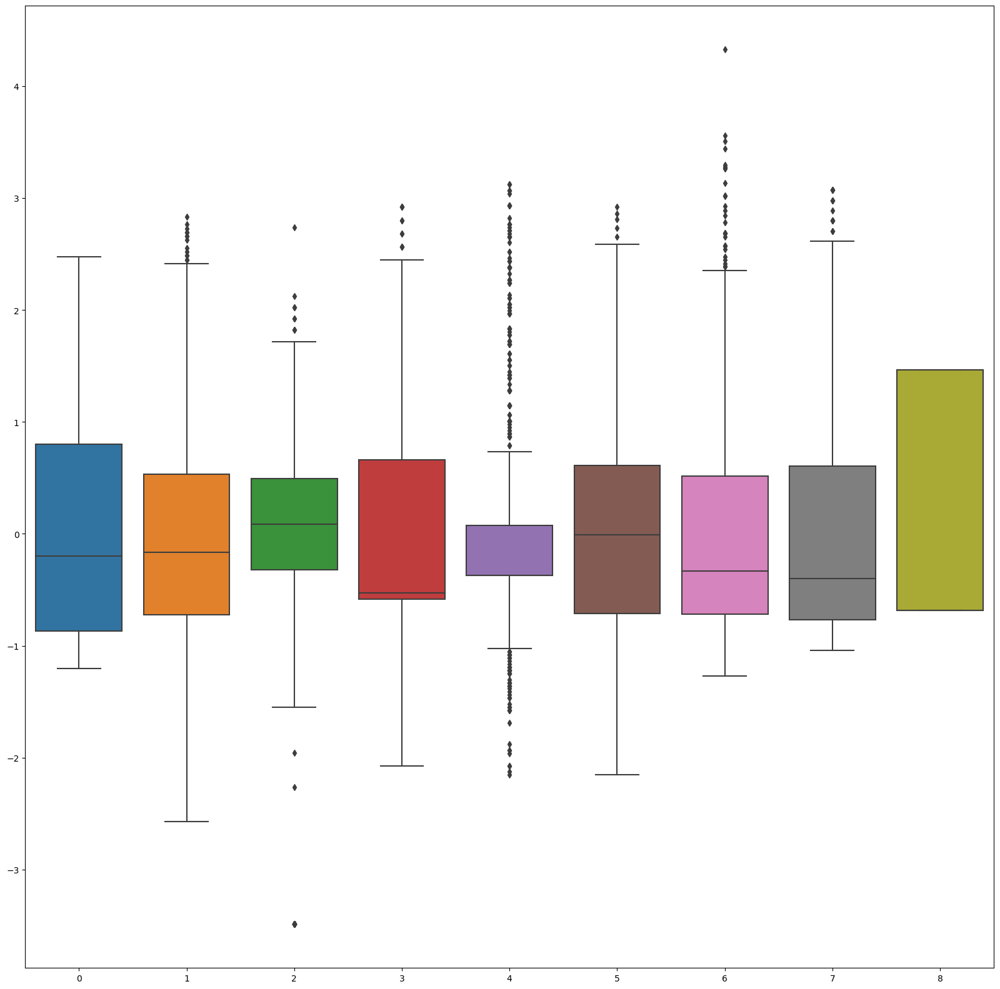

In [46]:
df_new_scalar = pd.DataFrame(scalar.fit_transform(df_new))
fig, ax = plt.subplots(figsize = (20,20))
sns.boxplot(data = df_new_scalar, ax = ax)

Now the data set range is between -2 to +2

Next the multi colinearity of the data set is to be checked

In [53]:
scalar = StandardScaler()
x_scaled = scalar.fit_transform(X)
x_scaled

array([[ 0.80230673,  1.05580875,  0.18717194, ...,  0.30802795,
         0.62838416,  1.61001692],
       [-0.86938227, -1.1421868 , -0.11919604, ..., -0.80937283,
        -0.3252998 , -0.12619781],
       [ 1.47098233,  2.27691738, -0.2213187 , ..., -1.33614749,
         0.78387611, -0.03481809],
       ...,
       [ 0.46796893,  0.11381065,  0.18717194, ..., -0.87322431,
        -0.69156972, -0.21757754],
       [-0.86938227,  0.28825474, -0.42556402, ..., -0.25067244,
        -0.33221055,  1.33587775],
       [-0.86938227, -0.86307626,  0.08504928, ..., -0.20278384,
        -0.44969336, -0.85723559]])

In [54]:
y

0      1
1      0
2      1
3      0
5      0
      ..
763    0
764    0
765    0
766    1
767    0
Name: Outcome, Length: 643, dtype: int64

In [61]:
def vif_score(x):
    scalar = StandardScaler()
    arr = scalar.fit_transform(x)
    return pd.DataFrame([[x.columns[i], variance_inflation_factor(arr,i)] for i in range(arr.shape[1])], columns=["FEATURES",vif_score])


In [62]:
vif_score(X)

,FEATURES,<function vif_score at 0x0000026BD15E5AF0>
0,Pregnancies,1.438139
1,Glucose,1.246438
2,BloodPressure,1.120395
3,SkinThickness,1.442778
4,Insulin,1.207078
5,BMI,1.397110
6,DiabetesPedigreeFunction,1.041881
7,Age,1.610723


In [65]:
x_train, x_test, y_train, y_test = train_test_split(x_scaled,y, test_size=.20, random_state=144)

In [66]:
x_test

array([[-0.53504447, -0.40952162, -0.62980934, ..., -0.426264  ,
        -0.06614655, -0.94861532],
       [-1.20372007,  0.21847711, -0.62980934, ..., -1.57559051,
         0.02369324, -1.03999504],
       [-0.20070667, -0.40952162, -0.731932  , ..., -0.1229695 ,
        -0.52916702, -0.76585587],
       ...,
       [-0.53504447,  0.81158702, -0.52768668, ..., -1.00092725,
         0.87717128, -0.76585587],
       [ 0.13363113, -0.96774271, -3.48924383, ..., -0.58589268,
         0.56964276, -0.12619781],
       [-1.20372007, -0.16529989,  0.39141726, ...,  0.26013934,
        -0.57754229, -0.85723559]])

In [67]:
x_train

array([[ 1.80532012,  2.3118062 ,  0.85096923, ..., -0.26663531,
         2.65323488,  1.51863719],
       [-1.20372007, -0.65374335, -3.48924383, ..., -1.06477873,
        -0.66392671, -0.94861532],
       [ 0.80230673, -0.7584098 , -3.48924383, ..., -1.27229602,
        -0.88161544, -0.40033698],
       ...,
       [-0.20070667,  0.81158702, -3.48924383, ..., -0.26663531,
         1.09140463, -0.4917167 ],
       [-1.20372007, -0.44441044,  1.10627588, ..., -0.33048679,
        -0.8574278 ,  1.24449803],
       [-0.86938227, -0.96774271, -0.01707338, ..., -1.14459307,
         2.39408163,  0.3307008 ]])

In [84]:
logr = LogisticRegression(verbose=4, solver='liblinear') 

In [82]:
logr.fit(x_train,y_train)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


LogisticRegression(verbose=4)

In [83]:
logr.predict_proba([x_test[0]])

array([[0.85734259, 0.14265741]])

In [79]:
logr.predict([x_test[1]])

array([0], dtype=int64)

In [80]:
logr.predict_log_proba([x_test[1]])

array([[-0.1188205, -2.1889634]])

In [76]:
type(y_test)

pandas.core.series.Series

In [77]:
y_test.iloc[1]

0